In [ ]:
import torch
import numpy as np
seed = 1234
torch.manual_seed(seed)
np.random.seed(seed)

In [ ]:
import pandas as pd
import numpy as np
import scanpy as sc
import anndata as ad
import scipy.io
import matplotlib.pyplot as plt
import os
import sys

import STitch3D

import warnings
warnings.filterwarnings("ignore")

os.environ["CUDA_VISIBLE_DEVICES"] = "0"

In [3]:
mat = scipy.io.mmread("D:\STitch3D\DLPFC\DLPFC_SC_DATA\GSE144136\GSE144136_GeneBarcodeMatrix_Annotated.mtx")
meta = pd.read_csv("D:\STitch3D\DLPFC\DLPFC_SC_DATA\GSE144136\GSE144136_CellNames.csv", index_col=0)
meta.index = meta.x.values
group = [i.split('.')[1].split('_')[0] for i in list(meta.x.values)]
condition = [i.split('.')[1].split('_')[1] for i in list(meta.x.values)]
celltype = [i.split('.')[0] for i in list(meta.x.values)]
meta["group"] = group
meta["condition"] = condition
meta["celltype"] = celltype
genename = pd.read_csv("D:\STitch3D\DLPFC\DLPFC_SC_DATA\GSE144136\GSE144136_GeneNames.csv", index_col=0)
genename.index = genename.x.values
adata_ref = ad.AnnData(X=mat.tocsr().T)
adata_ref.obs = meta
adata_ref.var = genename
adata_ref = adata_ref[adata_ref.obs.condition.values.astype(str)=="Control", :]

In [4]:
adata_ref

View of AnnData object with n_obs × n_vars = 35212 × 30062
    obs: 'x', 'group', 'condition', 'celltype'
    var: 'x'

In [5]:
#spatial data
anno_df = pd.read_csv("D:\STitch3D\DLPFC/barcode_level_layer_map.tsv", sep='\t', header=None)

slice_idx = [151673, 151674, 151675, 151676]

adata_st1 = sc.read_visium(path="D:\STitch3D\DLPFC\\%d" % slice_idx[0],
                          count_file="%d_filtered_feature_bc_matrix.h5" % slice_idx[0])
adata_st1.obs['batch_name'] = slice_idx[0]
anno_df1 = anno_df.iloc[anno_df[1].values.astype(str) == str(slice_idx[0])]
anno_df1.columns = ["barcode", "slice_id", "layer"]
anno_df1.index = anno_df1['barcode']
adata_st1.obs = adata_st1.obs.join(anno_df1, how="left")
adata_st1 = adata_st1[adata_st1.obs['layer'].notna()]

adata_st2 = sc.read_visium(path="D:\STitch3D\DLPFC\\%d" % slice_idx[1],
                          count_file="%d_filtered_feature_bc_matrix.h5" % slice_idx[1])
adata_st2.obs['batch_name'] = slice_idx[1]
anno_df2 = anno_df.iloc[anno_df[1].values.astype(str) == str(slice_idx[1])]
anno_df2.columns = ["barcode", "slice_id", "layer"]
anno_df2.index = anno_df2['barcode']
adata_st2.obs = adata_st2.obs.join(anno_df2, how="left")
adata_st2 = adata_st2[adata_st2.obs['layer'].notna()]

adata_st3 = sc.read_visium(path="D:\STitch3D\DLPFC\\%d" % slice_idx[2],
                          count_file="%d_filtered_feature_bc_matrix.h5" % slice_idx[2])
adata_st3.obs['batch_name'] = slice_idx[2]
anno_df3 = anno_df.iloc[anno_df[1].values.astype(str) == str(slice_idx[2])]
anno_df3.columns = ["barcode", "slice_id", "layer"]
anno_df3.index = anno_df3['barcode']
adata_st3.obs = adata_st3.obs.join(anno_df3, how="left")
adata_st3 = adata_st3[adata_st3.obs['layer'].notna()]

adata_st4 = sc.read_visium(path="D:\STitch3D\DLPFC\\%d" % slice_idx[3],
                          count_file="%d_filtered_feature_bc_matrix.h5" % slice_idx[3])
adata_st4.obs['batch_name'] = slice_idx[3]
anno_df4 = anno_df.iloc[anno_df[1].values.astype(str) == str(slice_idx[3])]
anno_df4.columns = ["barcode", "slice_id", "layer"]
anno_df4.index = anno_df4['barcode']
adata_st4.obs = adata_st4.obs.join(anno_df4, how="left")
adata_st4 = adata_st4[adata_st4.obs['layer'].notna()]

In [6]:
adata_st_list_raw = [adata_st1, adata_st2, adata_st3, adata_st4]
adata_st_list_raw

[View of AnnData object with n_obs × n_vars = 3611 × 33538
     obs: 'in_tissue', 'array_row', 'array_col', 'batch_name', 'barcode', 'slice_id', 'layer'
     var: 'gene_ids', 'feature_types', 'genome'
     uns: 'spatial'
     obsm: 'spatial',
 View of AnnData object with n_obs × n_vars = 3635 × 33538
     obs: 'in_tissue', 'array_row', 'array_col', 'batch_name', 'barcode', 'slice_id', 'layer'
     var: 'gene_ids', 'feature_types', 'genome'
     uns: 'spatial'
     obsm: 'spatial',
 View of AnnData object with n_obs × n_vars = 3566 × 33538
     obs: 'in_tissue', 'array_row', 'array_col', 'batch_name', 'barcode', 'slice_id', 'layer'
     var: 'gene_ids', 'feature_types', 'genome'
     uns: 'spatial'
     obsm: 'spatial',
 View of AnnData object with n_obs × n_vars = 3431 × 33538
     obs: 'in_tissue', 'array_row', 'array_col', 'batch_name', 'barcode', 'slice_id', 'layer'
     var: 'gene_ids', 'feature_types', 'genome'
     uns: 'spatial'
     obsm: 'spatial']

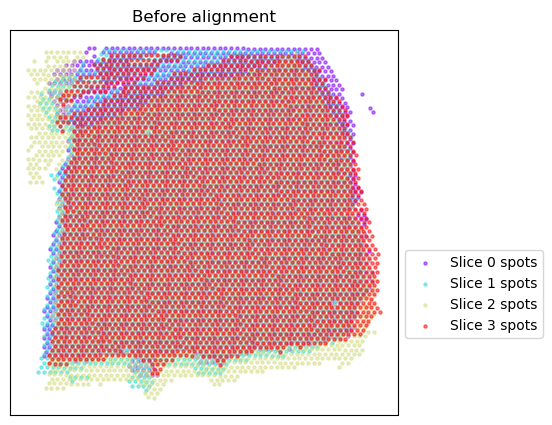

Using the Iterative Closest Point algorithm for alignemnt.
Detecting edges...
Aligning edges...


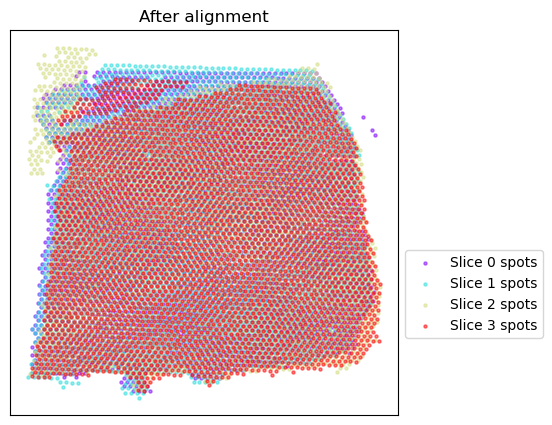

In [7]:
adata_st_list = STitch3D.utils.align_spots(adata_st_list_raw, plot=True)

In [11]:
adata_st_list

[AnnData object with n_obs × n_vars = 3611 × 33538
     obs: 'in_tissue', 'array_row', 'array_col', 'batch_name', 'barcode', 'slice_id', 'layer'
     var: 'gene_ids', 'feature_types', 'genome'
     uns: 'spatial'
     obsm: 'spatial', 'spatial_aligned',
 AnnData object with n_obs × n_vars = 3635 × 33538
     obs: 'in_tissue', 'array_row', 'array_col', 'batch_name', 'barcode', 'slice_id', 'layer'
     var: 'gene_ids', 'feature_types', 'genome'
     uns: 'spatial'
     obsm: 'spatial', 'spatial_aligned',
 AnnData object with n_obs × n_vars = 3566 × 33538
     obs: 'in_tissue', 'array_row', 'array_col', 'batch_name', 'barcode', 'slice_id', 'layer'
     var: 'gene_ids', 'feature_types', 'genome'
     uns: 'spatial'
     obsm: 'spatial', 'spatial_aligned',
 AnnData object with n_obs × n_vars = 3431 × 33538
     obs: 'in_tissue', 'array_row', 'array_col', 'batch_name', 'barcode', 'slice_id', 'layer'
     var: 'gene_ids', 'feature_types', 'genome'
     uns: 'spatial'
     obsm: 'spatial', 'sp

In [26]:
adata_ref

View of AnnData object with n_obs × n_vars = 35212 × 30062
    obs: 'x', 'group', 'condition', 'celltype'
    var: 'x'

In [27]:
celltype_list_use = ['Astros_1', 'Astros_2', 'Astros_3', 'Endo', 'Micro/Macro',
                     'Oligos_1', 'Oligos_2', 'Oligos_3',
                     'Ex_1_L5_6', 'Ex_2_L5', 'Ex_3_L4_5', 'Ex_4_L_6', 'Ex_5_L5',
                     'Ex_6_L4_6', 'Ex_7_L4_6', 'Ex_8_L5_6', 'Ex_9_L5_6', 'Ex_10_L2_4']

adata_st, adata_basis = STitch3D.utils.preprocess(adata_st_list,
                                                  adata_ref,
                                                  celltype_ref=celltype_list_use,
                                                  sample_col="group",
                                                  slice_dist_micron=[10., 300., 10.],
                                                  n_hvg_group=500)

Finding highly variable genes...
Unexpected exception formatting exception. Falling back to standard exception


Traceback (most recent call last):
  File "D:\Anaconda3\envs\Spoint\lib\site-packages\pandas\core\ops\array_ops.py", line 362, in na_logical_op
    result = op(x, y)
TypeError: unsupported operand type(s) for &: 'str' and 'str'

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "D:\Anaconda3\envs\Spoint\lib\site-packages\IPython\core\interactiveshell.py", line 3550, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "C:\Users\DELL\AppData\Local\Temp\ipykernel_9308\2134623419.py", line 6, in <module>
    adata_st, adata_basis = STitch3D.utils.preprocess(adata_st_list,
  File "D:\pythonplaces\STitch3D-main\STitch3D\utils.py", line 205, in preprocess
    print("adata_st_new.var.index",adata_st_new.var.index)
  File "D:\Anaconda3\envs\Spoint\lib\site-packages\pandas\core\ops\common.py", line 76, in new_method
    return method(self, other)
  File "D:\Anaconda3\envs\Spoint\lib\site-packages\pandas\core\arrayl

In [19]:
adata_st.obs['batch_name']

AAACAAGTATCTCCCA-1-slice0    151673
AAACAATCTACTAGCA-1-slice0    151673
AAACACCAATAACTGC-1-slice0    151673
AAACAGAGCGACTCCT-1-slice0    151673
AAACAGCTTTCAGAAG-1-slice0    151673
                              ...  
TTGTTGTGTGTCAAGA-1-slice3    151676
TTGTTTCACATCCAGG-1-slice3    151676
TTGTTTCATTAGTCTA-1-slice3    151676
TTGTTTCCATACAACT-1-slice3    151676
TTGTTTGTGTAAATTC-1-slice3    151676
Name: batch_name, Length: 14243, dtype: int64

In [10]:
adata_st.X[0]

<1x4558 sparse matrix of type '<class 'numpy.float32'>'
	with 1258 stored elements in Compressed Sparse Row format>

In [12]:
adata_basis.obs.index

Index(['Astros_1', 'Astros_2', 'Astros_3', 'Endo', 'Ex_10_L2_4', 'Ex_1_L5_6',
       'Ex_2_L5', 'Ex_3_L4_5', 'Ex_4_L_6', 'Ex_5_L5', 'Ex_6_L4_6', 'Ex_7_L4_6',
       'Ex_8_L5_6', 'Ex_9_L5_6', 'Micro/Macro', 'Oligos_1', 'Oligos_2',
       'Oligos_3'],
      dtype='object', name='celltype')

In [22]:
adata_st

AnnData object with n_obs × n_vars = 14243 × 4558
    obs: 'in_tissue', 'array_row', 'array_col', 'barcode', 'slice_id', 'layer', 'slice', 'batch', 'library_size', 'GM', 'Cluster'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'log1p', 'neighbors', 'paga', 'layer_sizes', 'layer_colors'
    obsm: 'spatial', 'spatial_aligned', 'count', 'graph', '3D_coor', 'latent', 'X_umap'
    obsp: 'distances', 'connectivities'

In [13]:
model = STitch3D.model.Model(adata_st, adata_basis)

model.train()

  0%|          | 2/20000 [00:01<3:52:38,  1.43it/s]

Step: 0, Loss: 2433.4980, d_loss: 2427.9316, f_loss: 55.6641


 10%|█         | 2002/20000 [04:35<41:08,  7.29it/s]

Step: 2000, Loss: 742.1216, d_loss: 738.8191, f_loss: 33.0258


 20%|██        | 4002/20000 [09:12<36:32,  7.30it/s]

Step: 4000, Loss: 703.5994, d_loss: 700.3200, f_loss: 32.7938


 30%|███       | 6002/20000 [13:48<32:07,  7.26it/s]

Step: 6000, Loss: 692.5285, d_loss: 689.2636, f_loss: 32.6491


 40%|████      | 8002/20000 [18:25<27:31,  7.27it/s]

Step: 8000, Loss: 692.1249, d_loss: 688.8333, f_loss: 32.9161


 50%|█████     | 10002/20000 [23:02<22:55,  7.27it/s]

Step: 10000, Loss: 689.6157, d_loss: 686.3749, f_loss: 32.4071


 60%|██████    | 12002/20000 [27:39<18:14,  7.30it/s]

Step: 12000, Loss: 688.5173, d_loss: 685.2852, f_loss: 32.3208


 70%|███████   | 14002/20000 [32:15<13:47,  7.25it/s]

Step: 14000, Loss: 687.7527, d_loss: 684.5263, f_loss: 32.2643


 80%|████████  | 16002/20000 [36:52<09:09,  7.28it/s]

Step: 16000, Loss: 687.4671, d_loss: 684.2420, f_loss: 32.2511


 90%|█████████ | 18002/20000 [41:28<04:33,  7.30it/s]

Step: 18000, Loss: 687.0867, d_loss: 683.8650, f_loss: 32.2175


100%|██████████| 20000/20000 [46:04<00:00,  7.23it/s]


In [14]:
save_path = "./results_DLPFC"
result = model.eval(adata_st_list_raw, save=True, output_path=save_path)

In [60]:
model.beta.shape

torch.Size([14243, 18])

In [54]:
result

[AnnData object with n_obs × n_vars = 3611 × 33538
     obs: 'in_tissue', 'array_row', 'array_col', 'barcode', 'slice_id', 'layer', 'Astros_1', 'Astros_2', 'Astros_3', 'Endo', 'Ex_10_L2_4', 'Ex_1_L5_6', 'Ex_2_L5', 'Ex_3_L4_5', 'Ex_4_L_6', 'Ex_5_L5', 'Ex_6_L4_6', 'Ex_7_L4_6', 'Ex_8_L5_6', 'Ex_9_L5_6', 'Micro/Macro', 'Oligos_1', 'Oligos_2', 'Oligos_3', 'GM', 'Cluster'
     var: 'gene_ids', 'feature_types', 'genome'
     uns: 'spatial'
     obsm: 'spatial', 'spatial_aligned',
 AnnData object with n_obs × n_vars = 3635 × 33538
     obs: 'in_tissue', 'array_row', 'array_col', 'barcode', 'slice_id', 'layer', 'Astros_1', 'Astros_2', 'Astros_3', 'Endo', 'Ex_10_L2_4', 'Ex_1_L5_6', 'Ex_2_L5', 'Ex_3_L4_5', 'Ex_4_L_6', 'Ex_5_L5', 'Ex_6_L4_6', 'Ex_7_L4_6', 'Ex_8_L5_6', 'Ex_9_L5_6', 'Micro/Macro', 'Oligos_1', 'Oligos_2', 'Oligos_3', 'GM', 'Cluster'
     var: 'gene_ids', 'feature_types', 'genome'
     uns: 'spatial'
     obsm: 'spatial', 'spatial_aligned',
 AnnData object with n_obs × n_vars = 3566 ×

In [49]:
result[0].obs[celltype_list_use[0]]

AAACAAGTATCTCCCA-1-slice0    0.009895
AAACAATCTACTAGCA-1-slice0    0.017240
AAACACCAATAACTGC-1-slice0    0.063973
AAACAGAGCGACTCCT-1-slice0    0.029975
AAACAGCTTTCAGAAG-1-slice0    0.014404
                               ...   
TTGTTTCACATCCAGG-1-slice0    0.036344
TTGTTTCATTAGTCTA-1-slice0    0.175655
TTGTTTCCATACAACT-1-slice0    0.029146
TTGTTTGTATTACACG-1-slice0    0.086267
TTGTTTGTGTAAATTC-1-slice0    0.000499
Name: Astros_1, Length: 3611, dtype: float32

In [32]:
adata_test = model.adata_st
adata_test

AnnData object with n_obs × n_vars = 14243 × 4558
    obs: 'in_tissue', 'array_row', 'array_col', 'barcode', 'slice_id', 'layer', 'slice', 'batch', 'library_size', 'GM', 'Cluster'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'log1p', 'neighbors', 'paga', 'layer_sizes', 'layer_colors'
    obsm: 'spatial', 'spatial_aligned', 'count', 'graph', '3D_coor', 'latent', 'X_umap'
    obsp: 'distances', 'connectivities'

In [31]:
adata_concat = model.adata_st
adata_concat

AnnData object with n_obs × n_vars = 14243 × 4558
    obs: 'in_tissue', 'array_row', 'array_col', 'barcode', 'slice_id', 'layer', 'slice', 'batch', 'library_size', 'GM', 'Cluster'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'log1p', 'neighbors', 'paga', 'layer_sizes', 'layer_colors'
    obsm: 'spatial', 'spatial_aligned', 'count', 'graph', '3D_coor', 'latent', 'X_umap'
    obsp: 'distances', 'connectivities'

In [61]:
adata_concat.obsm['beta'] = model.beta.detach().cpu().numpy()
adata_concat

AnnData object with n_obs × n_vars = 14243 × 4558
    obs: 'in_tissue', 'array_row', 'array_col', 'barcode', 'slice_id', 'layer', 'slice', 'batch', 'library_size', 'GM', 'Cluster'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'log1p', 'neighbors', 'paga', 'layer_sizes', 'layer_colors'
    obsm: 'spatial', 'spatial_aligned', 'count', 'graph', '3D_coor', 'latent', 'X_umap', 'beta'
    obsp: 'distances', 'connectivities'

In [62]:
# sc.write('./adata_concat.h5ad',adata_concat)

In [39]:
from sklearn.metrics import adjusted_rand_score as ari_score
print('raw, ARI = %01.3f' % ari_score(adata_test.obs['layer'], adata_test.obs['Cluster']))

raw, ARI = 0.602


In [15]:
from sklearn.mixture import GaussianMixture

np.random.seed(1234)
gm = GaussianMixture(n_components=7, covariance_type='tied', init_params='kmeans')
y = gm.fit_predict(model.adata_st.obsm['latent'], y=None)
model.adata_st.obs["GM"] = y
model.adata_st.obs["GM"].to_csv(os.path.join(save_path, "clustering_result.csv"))

# Restoring clustering labels to result
order = [2,4,6,0,3,5,1] # reordering cluster labels
model.adata_st.obs["Cluster"] = [order[label] for label in model.adata_st.obs["GM"].values]
for i in range(len(result)):
    result[i].obs["GM"] = model.adata_st.obs.loc[result[i].obs_names, ]["GM"]
    result[i].obs["Cluster"] = model.adata_st.obs.loc[result[i].obs_names, ]["Cluster"]

Slice 151673 spatial domain detection result:


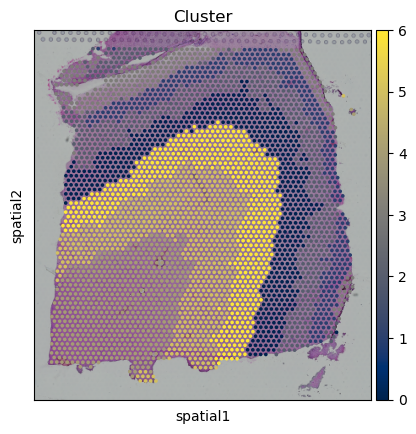

Slice 151674 spatial domain detection result:


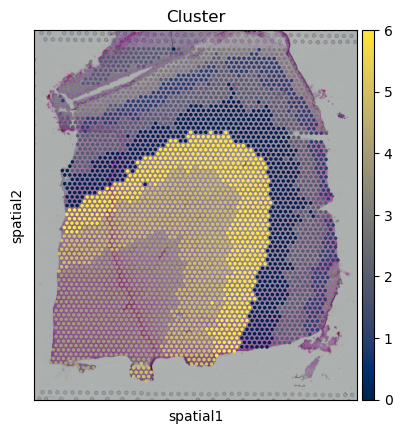

Slice 151675 spatial domain detection result:


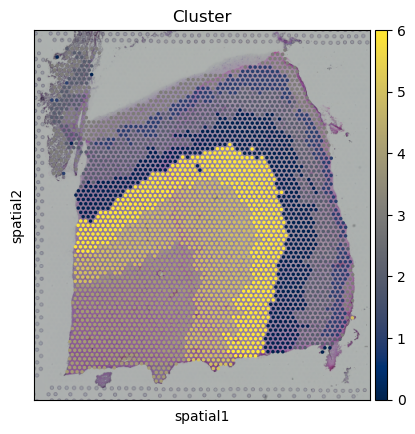

Slice 151676 spatial domain detection result:


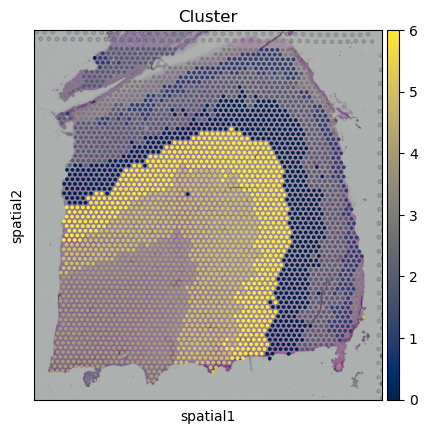

In [16]:
for i, adata_st_i in enumerate(result):
    print("Slice %d spatial domain detection result:" % slice_idx[i])
    sc.pl.spatial(adata_st_i, img_key="lowres", color="Cluster", color_map="cividis", size=1.)

Slice 151673 cell-type deconvolution result:


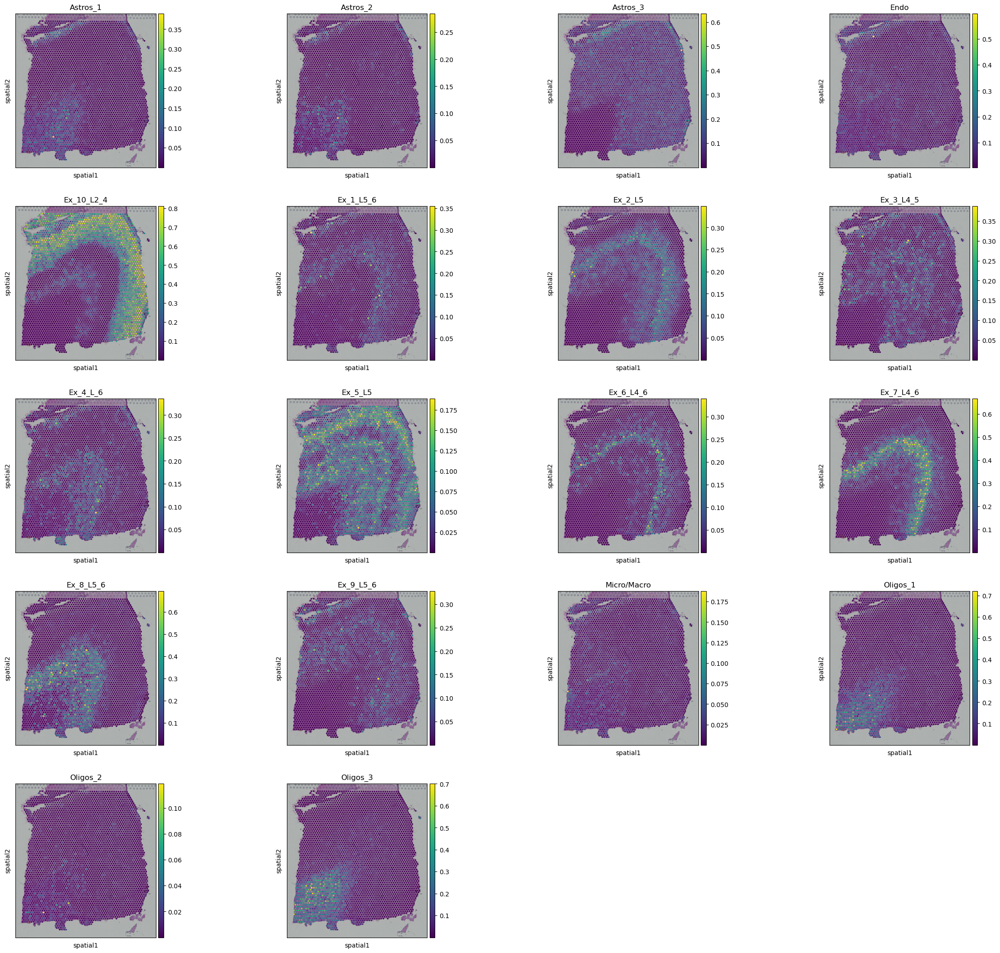

Slice 151674 cell-type deconvolution result:


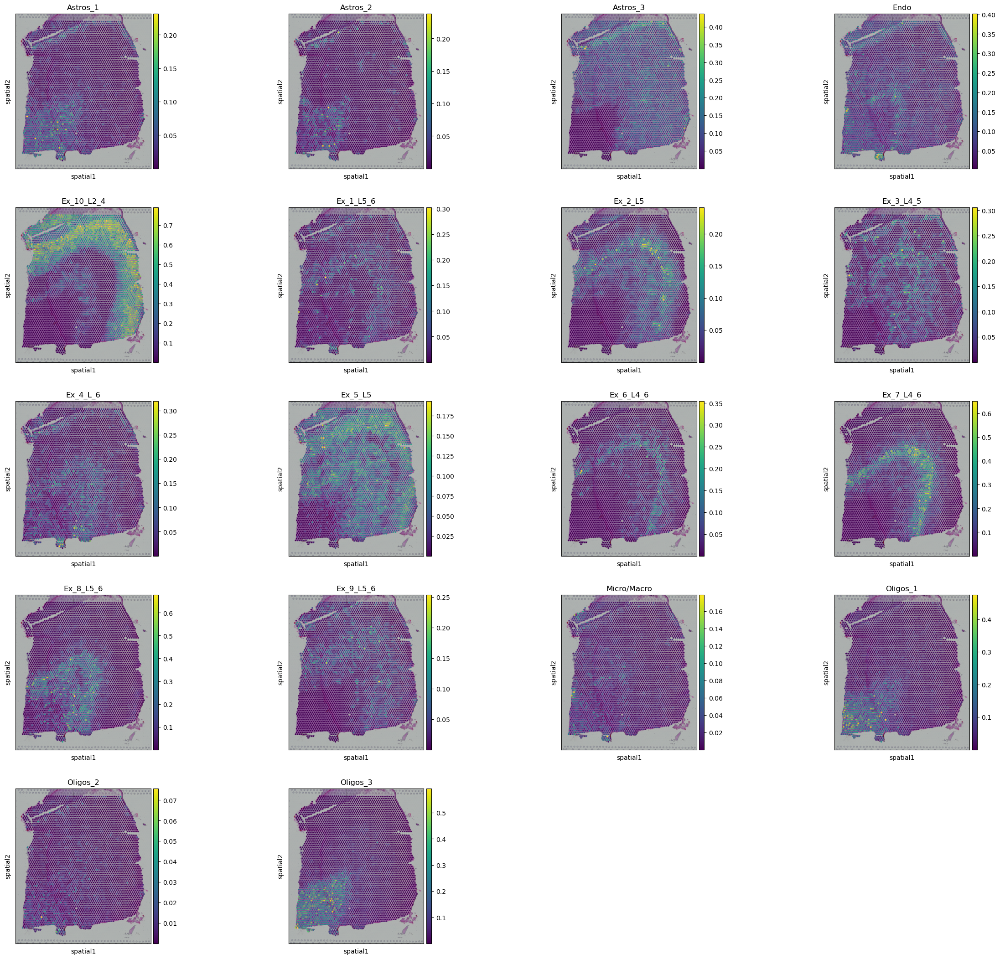

Slice 151675 cell-type deconvolution result:


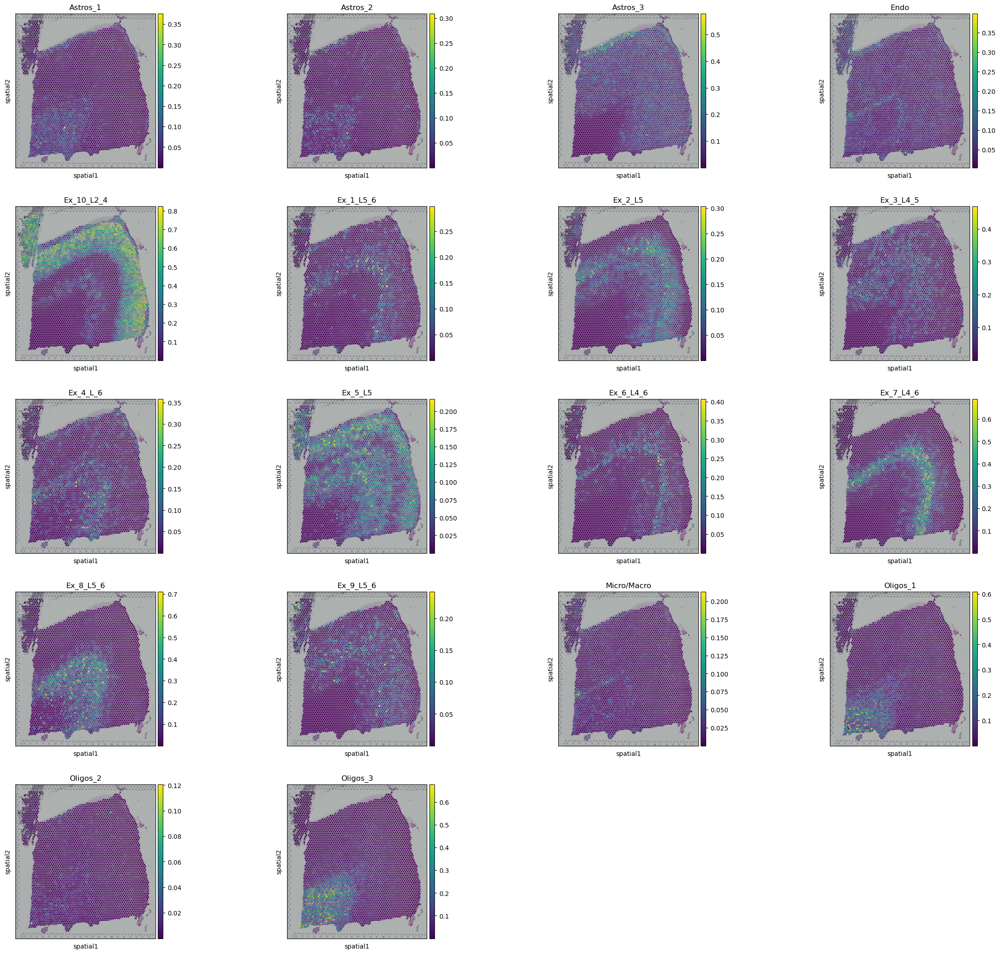

Slice 151676 cell-type deconvolution result:


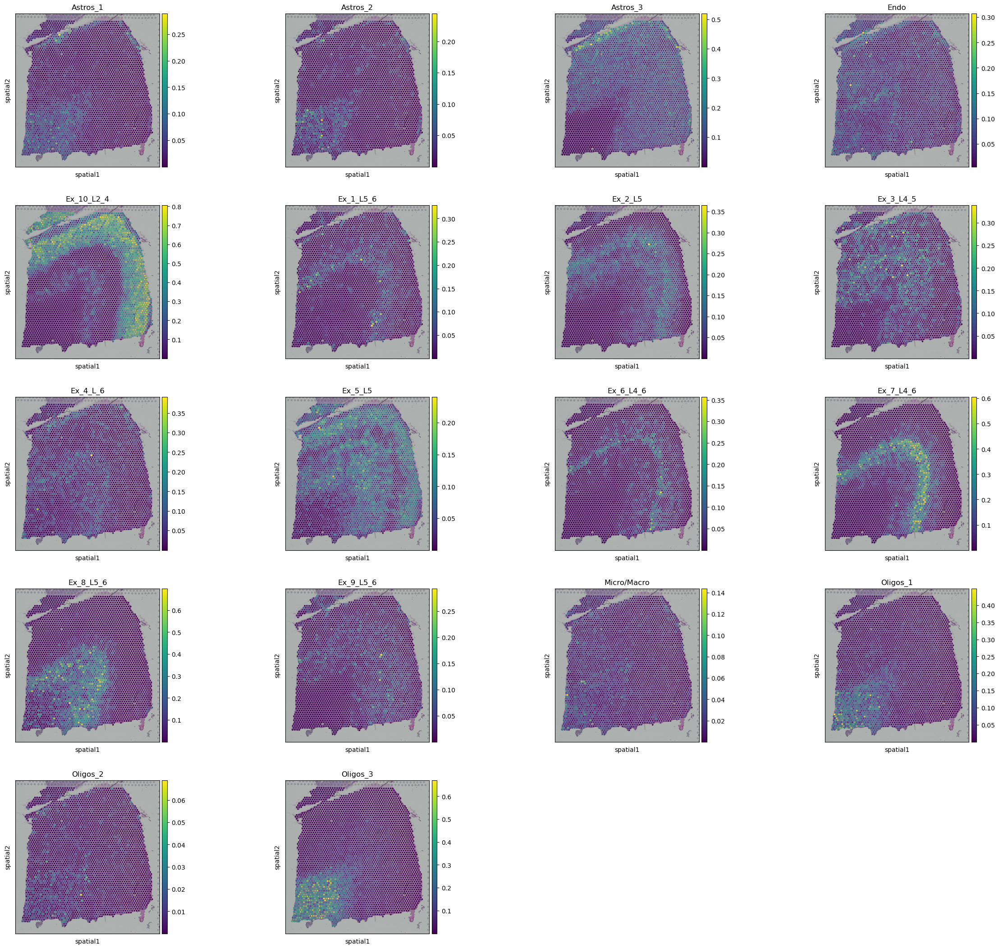

In [17]:
for i, adata_st_i in enumerate(result):
    print("Slice %d cell-type deconvolution result:" % slice_idx[i])
    sc.pl.spatial(adata_st_i, img_key="lowres", color=list(adata_basis.obs.index), size=1.)

In [18]:
import umap

reducer = umap.UMAP(n_neighbors=30,
                    n_components=2,
                    metric="correlation",
                    n_epochs=None,
                    learning_rate=1.0,
                    min_dist=0.3,
                    spread=1.0,
                    set_op_mix_ratio=1.0,
                    local_connectivity=1,
                    repulsion_strength=1,
                    negative_sample_rate=5,
                    a=None,
                    b=None,
                    random_state=1234,
                    metric_kwds=None,
                    angular_rp_forest=False,
                    verbose=True)

embedding = reducer.fit_transform(model.adata_st.obsm['latent'])

n_spots = embedding.shape[0]
size = 120000 / n_spots

UMAP(angular_rp_forest=True, local_connectivity=1, metric='correlation', min_dist=0.3, n_neighbors=30, random_state=1234, repulsion_strength=1, verbose=True)
Mon Apr 22 11:41:10 2024 Construct fuzzy simplicial set
Mon Apr 22 11:41:10 2024 Finding Nearest Neighbors
Mon Apr 22 11:41:10 2024 Building RP forest with 11 trees
Mon Apr 22 11:41:12 2024 NN descent for 14 iterations
	 1  /  14
	 2  /  14
	 3  /  14
	Stopping threshold met -- exiting after 3 iterations
Mon Apr 22 11:41:24 2024 Finished Nearest Neighbor Search
Mon Apr 22 11:41:25 2024 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Mon Apr 22 11:41:32 2024 Finished embedding


In [19]:
model.adata_st.obsm["X_umap"] = embedding
sc.pp.neighbors(model.adata_st, use_rep='latent')
sc.tl.paga(model.adata_st, groups='layer')

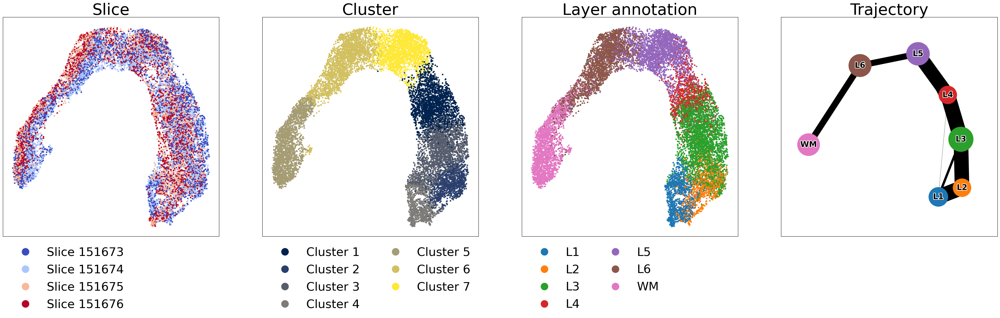

In [20]:
from sklearn import preprocessing
from matplotlib.colors import ListedColormap

le_slice = preprocessing.LabelEncoder()
label_slice = le_slice.fit_transform(model.adata_st.obs['slice_id'])

le_layer = preprocessing.LabelEncoder()
label_layer = le_layer.fit_transform(model.adata_st.obs['layer'])

np.random.seed(1234)
order = np.arange(n_spots)
np.random.shuffle(order)

f = plt.figure(figsize=(45,10))

ax1 = f.add_subplot(1,4,1)
scatter1 = ax1.scatter(embedding[order, 0], embedding[order, 1],
                       s=size, c=label_slice[order], cmap='coolwarm')
ax1.set_title("Slice", fontsize=40)
ax1.tick_params(axis='both',bottom=False, top=False, left=False, right=False, labelleft=False, labelbottom=False, grid_alpha=0)

l1 = ax1.legend(handles=scatter1.legend_elements()[0],
                labels=["Slice %d" % i for i in slice_idx],
                loc="upper left", bbox_to_anchor=(0., 0.),
                markerscale=3., title_fontsize=45, fontsize=30, frameon=False, ncol=1)
l1._legend_box.align = "left"


ax2 = f.add_subplot(1,4,2)
scatter2 = ax2.scatter(embedding[order, 0], embedding[order, 1],
                       s=size, c=model.adata_st.obs['Cluster'][order], cmap='cividis')
ax2.set_title("Cluster", fontsize=40)
ax2.tick_params(axis='both',bottom=False, top=False, left=False, right=False, labelleft=False, labelbottom=False, grid_alpha=0)

l2 = ax2.legend(handles=scatter2.legend_elements()[0],
                labels=["Cluster %d" % i for i in range(1, 8)],
                loc="upper left", bbox_to_anchor=(0., 0.),
                markerscale=3., title_fontsize=45, fontsize=30, frameon=False, ncol=2)

l2._legend_box.align = "left"

ax3 = f.add_subplot(1,4,3)
scatter3 = ax3.scatter(embedding[order, 0], embedding[order, 1],
                       s=size, c=label_layer[order], cmap=ListedColormap(["#1f77b4", "#ff7f0e", "#2ca02c", "#d62728", "#9467bd", "#8c564b", "#e377c2"]))
ax3.set_title("Layer annotation", fontsize=40)
ax3.tick_params(axis='both',bottom=False, top=False, left=False, right=False, labelleft=False, labelbottom=False, grid_alpha=0)

l3 = ax3.legend(handles=scatter3.legend_elements()[0],
                labels=sorted(set(adata_st.obs['layer'].values)),
                loc="upper left", bbox_to_anchor=(0., 0.),
                markerscale=3., title_fontsize=45, fontsize=30, frameon=False, ncol=2)

l3._legend_box.align = "left"

ax4 = f.add_subplot(1,4,4)
ax4.set_title("Trajectory", fontsize=40)
ax4.tick_params(axis='both',bottom=False, top=False, left=False, right=False, labelleft=False, labelbottom=False, grid_alpha=0)
ax4.set_xlim(ax3.get_xlim())
ax4.set_ylim(ax3.get_ylim())

pos = []
for layer in ["L1", "L2", "L3", "L4", "L5", "L6", "WM"]:
    center = np.mean(embedding[model.adata_st.obs['layer'].values.astype(str)==layer, :], axis=0)
    pos.append(center)

sc.pl.paga(adata_st, pos=np.array(pos), node_size_scale=20, edge_width_scale=5, fontsize=20, fontoutline=3, ax=ax4)

f.subplots_adjust(hspace=.1, wspace=.1)
plt.show()